WAV file loaded from local path: C:\Users\egorp\Nextcloud\code\public_repos\audiospylt\tutorials\samples\saariaho_flute.wav
Number of audio channels: 1
Sampling rate: 44100 Hz
WAV file loaded from samples/saariaho_flute.wav
Total duration: 7.379 seconds


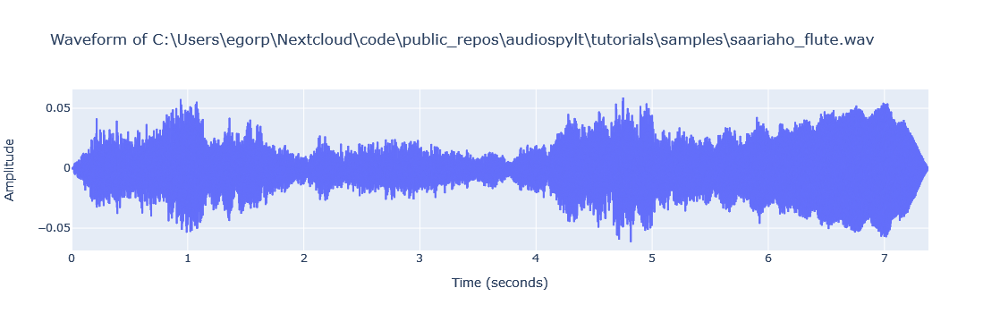

In [1]:
import sys
sys.path.append('../')

from IPython.display import Audio, display
from py_scripts.audio_utils import load_wav_from_source, load_audio_data, display_audio_properties, plot_waveform
import numpy as np

# Adjustable variables
wav_source = 'samples/saariaho_flute.wav'
desired_sample_rate = None
convert_to_mono = True

# Load WAV and audio data
wav_filename = load_wav_from_source(wav_source)
audio_data, sample_rate = load_audio_data(wav_filename, desired_sample_rate, convert_to_mono)

# Display audio properties
num_channels = display_audio_properties(audio_data, sample_rate, wav_source)
# Plot waveform and get duration
duration = plot_waveform(audio_data, sample_rate, wav_filename)

# If the audio data is multi-channel, select the first channel to display
if num_channels > 1:
    audio_data = audio_data[:, 0]

# Create an audio player for the loaded file
display(Audio(audio_data, rate=sample_rate))

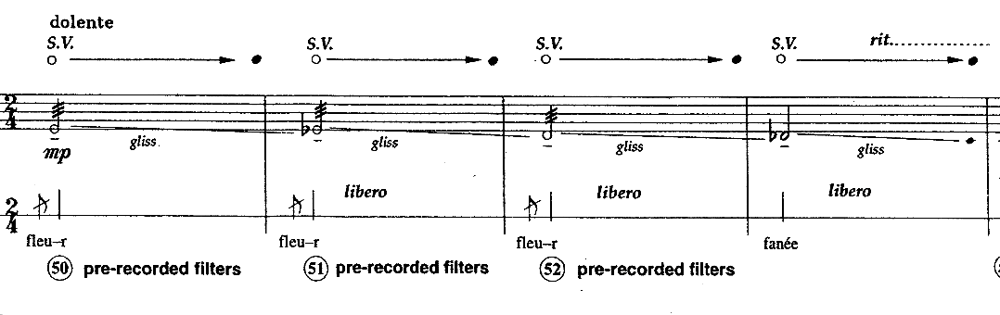

In [2]:
from IPython.display import Image
Image(filename='samples/saariaho_sheet.png')

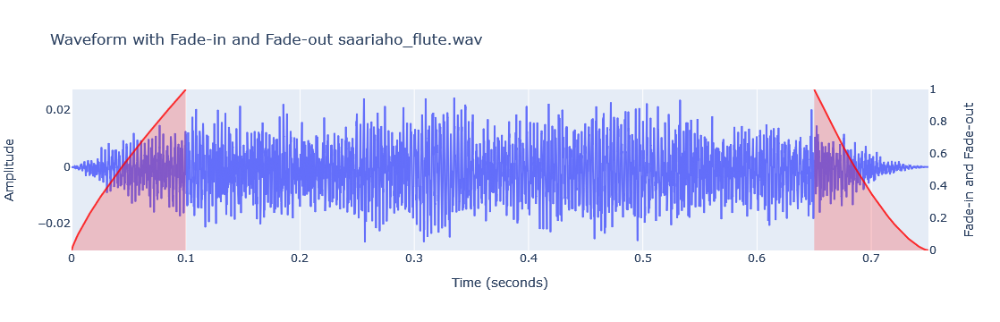

In [3]:
from py_scripts.audio_utils import trim_and_fade_audio

start_time = 2.45
end_time = 3.2
add_fades = True
fade_in_duration = 0.1
fade_out_duration = 0.1
fade_in_exponent = 0.8
fade_out_exponent = 1.5

cut_audio_data, cut_duration = trim_and_fade_audio(audio_data, sample_rate, num_channels, duration, wav_filename, start_time, 
                                                   end_time, add_fades, fade_in_duration, fade_out_duration, 
                                                   fade_in_exponent, fade_out_exponent)

# Create an audio player for the loaded file
display(Audio(cut_audio_data, rate=sample_rate))

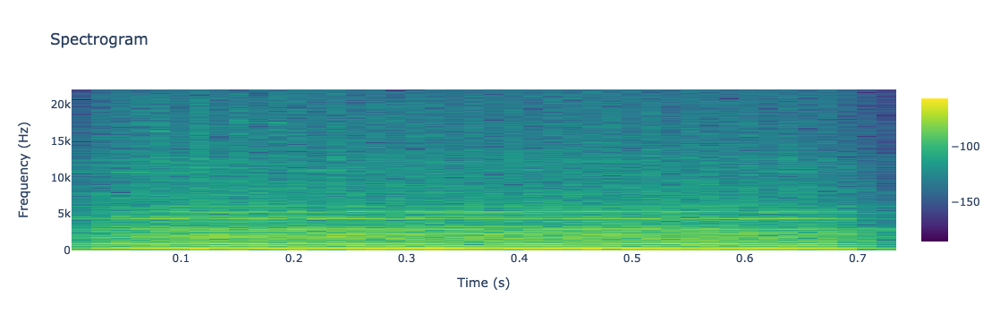

In [4]:
import numpy as np
import plotly.graph_objects as go
from scipy.signal import spectrogram

# Compute the spectrogram data
frequencies, times, Sxx = spectrogram(cut_audio_data, fs=sample_rate, nperseg=1024, noverlap=256)

# Convert the amplitude spectrogram to dB scale
Sxx_dB = 10 * np.log10(Sxx)

# Display the spectrogram using Plotly
fig = go.Figure(data=go.Heatmap(z=Sxx_dB, x=times, y=frequencies, colorscale='Viridis', zmin=np.min(Sxx_dB), zmax=np.max(Sxx_dB)))
fig.update_layout(title="Spectrogram",
                  xaxis_title="Time (s)",
                  yaxis_title="Frequency (Hz)")

fig.show()

Save trimmed file if needed:

In [5]:
from py_scripts.generate_wave_file import generate_wave_file

y_combined_no_nan = np.nan_to_num(cut_audio_data)

generate_wave_file(y_combined_no_nan, sample_rate, fs_target_name='44.1kHz', bit_rate=24)

# add custom_filename='my_custom_filename.wav' if needed


[2024-05-14 11:50:03] 24-bit wave file with 44.1kHz sampling rate saved successfully to: C:\Users\egorp\Nextcloud\code\audiospylt_beta\tutorials\rendered_audio\generated_wave_file_44.1kHz_24bit_11_50_03.wav


'C:\\Users\\egorp\\Nextcloud\\code\\audiospylt_beta\\tutorials\\rendered_audio\\generated_wave_file_44.1kHz_24bit_11_50_03.wav'

File name: samples/saariaho_flute.wav
Duration (s): 0.75
Sampling rate (Hz): 44100

Maximum amplitude value: 0.002785
Total number of bands: 16538
Frequency resolution (Hz): 1.333333

Amplitude Threshold 1: 5e-05
Amplitude Threshold 2: 0.004
Frequency Threshold 1 (Hz): 170
Frequency Threshold 2 (Hz): 7500

Peaks:


,Frequency (Hz),Amplitude
0,173.333333,0.000110
1,182.666667,0.000260
2,190.666667,0.000226
3,201.333333,0.000260
4,208.000000,0.000757
...,...,...
60,2904.000000,0.000113
61,2920.000000,0.000213
62,4330.666667,0.000106
63,4337.333333,0.000117


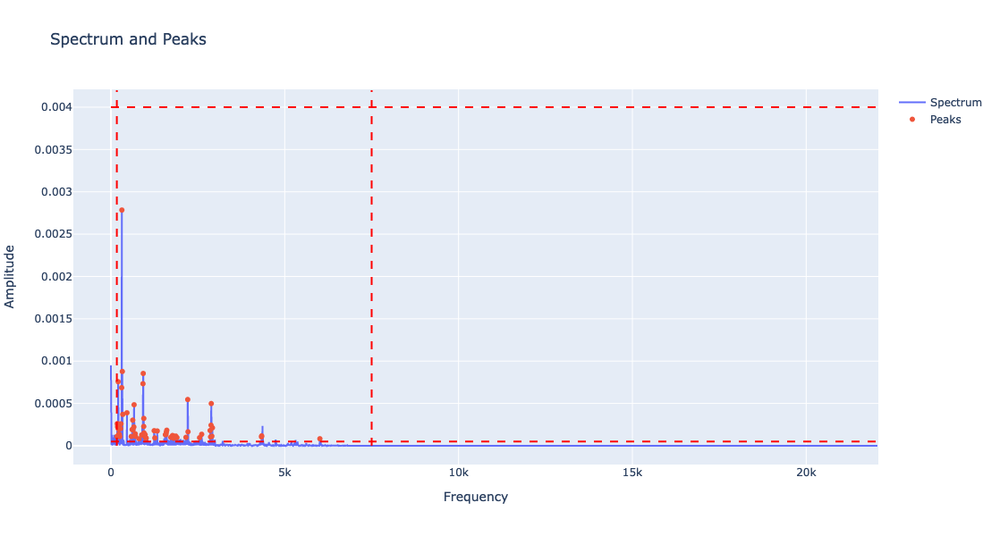

In [5]:
import pandas as pd

from py_scripts.dft_analysis import analyze_signal


peaks_df = analyze_signal(
        signal=cut_audio_data, 
        sr=sample_rate, 
        filename=wav_source,
        window_type='boxcar', 
        thresh_amp_low=0.00005, 
        thresh_amp_high=0.004, 
        thresh_freq_low=170, 
        thresh_freq_high=7500, 
        prominence=0.000075, 
        width=1.25,
        show_peaks=True, 
        show_plot=True
    )


In [7]:
import os
from datetime import datetime

# Define the path for the /tsv subfolder
output_directory = 'tsv'

# Check if the directory exists; if not, create it
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Define the filename path to save inside the /tsv subfolder
filename = os.path.join(output_directory, 'noanoa_single.tsv')

try:
    peaks_df.to_csv(filename, sep='\t', index=False)
    print(f"Data saved successfully to {os.path.abspath(filename)} at {datetime.now()}.")
except:
    print("Error: data could not be saved.")


Data saved successfully to C:\Users\egorp\Nextcloud\code\audiospylt_beta\tutorials\tsv\noanoa_single.tsv at 2024-05-14 11:50:04.197692.


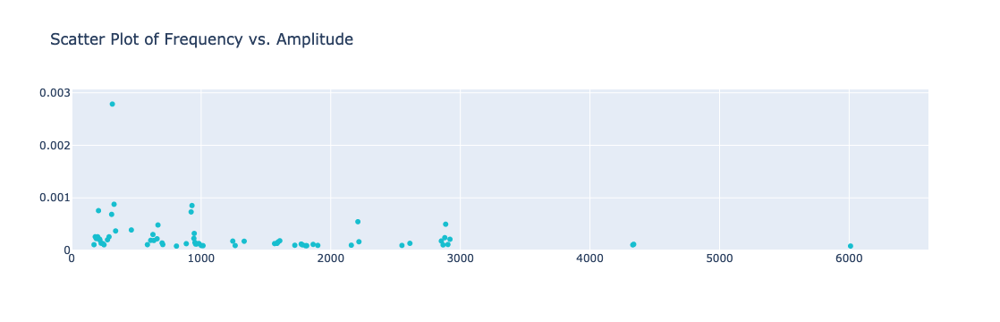

In [6]:
from py_scripts.multiplotter import plot_scatter

plot_scatter(dfs=[peaks_df], mode='markers')

In [6]:
from py_scripts.mei import process_and_visualize

process_and_visualize(peaks_df, resolution='half_tone_deviation', include_natural_accidentals=False, save_mei=False, save_path='my_output.mei', display_df=True)

,Frequency (Hz),MIDI Value,MIDI Cent Deviation,Pitch Name,Note,Octave,Alter
0,173.333333,53,-13,F3,F,3,n
1,182.666667,54,-22,F#3,F,3,s
2,190.666667,55,-48,G3,G,3,n
3,201.333333,55,+46,G3,G,3,n
4,208.000000,56,+3,G#3,G,3,s
...,...,...,...,...,...,...,...
60,2904.000000,102,-33,F#7,F,7,s
61,2920.000000,102,-24,F#7,F,7,s
62,4330.666667,109,-41,C#8,C,8,s
63,4337.333333,109,-39,C#8,C,8,s


In [7]:
import numpy as np

# duplicate the columns into a new dataframe
peaks_df.replace([np.inf, -np.inf], np.nan, inplace=True)

double_df = pd.DataFrame({
    "freq_data1": peaks_df["Frequency (Hz)"],
    "amp_data1": peaks_df["Amplitude"],
    "freq_data2": peaks_df["Frequency (Hz)"],
    "amp_data2": peaks_df["Amplitude"]
})

def process_df(input_df, freq_start_col, amp_start_col, freq_stop_col, amp_stop_col, wave_stop_value, override_amp_value=None, scale_amp_value=True):
    # Scaling amplitude if required
    if scale_amp_value:
        amp_start_scaled = input_df[amp_start_col] / input_df[amp_start_col].max()
        amp_stop_max = input_df[amp_stop_col] / input_df[amp_stop_col].max()
    else:
        amp_start_scaled = input_df[amp_start_col]
        amp_stop_max = input_df[amp_stop_col]
    
    # Overriding amplitude values if required
    if override_amp_value is not None:
        amp_min = [override_amp_value] * len(input_df)
        amp_max = [override_amp_value] * len(input_df)
    else:
        amp_min = amp_start_scaled
        amp_max = amp_stop_max

    new_data = {
        "freq_start": input_df[freq_start_col],
        "freq_stop": input_df[freq_stop_col],
        "time_start": [0.0] * len(input_df),
        "time_stop": [wave_stop_value] * len(input_df),
        "amp_min": amp_min,
        "amp_max": amp_max
    }
    
    return pd.DataFrame(new_data)

wave_stop_value = 15.0
override_amp_value = None
scale_amp_value = True

new_df = process_df(double_df, 'freq_data1', 'amp_data1', 'freq_data2', 'amp_data2', wave_stop_value, override_amp_value, scale_amp_value)
display(new_df)

,freq_start,freq_stop,time_start,time_stop,amp_min,amp_max
0,173.333333,173.333333,0.0,15.0,0.039416,0.039416
1,182.666667,182.666667,0.0,15.0,0.093499,0.093499
2,190.666667,190.666667,0.0,15.0,0.081042,0.081042
3,201.333333,201.333333,0.0,15.0,0.093302,0.093302
4,208.000000,208.000000,0.0,15.0,0.271892,0.271892
...,...,...,...,...,...,...
60,2904.000000,2904.000000,0.0,15.0,0.040631,0.040631
61,2920.000000,2920.000000,0.0,15.0,0.076311,0.076311
62,4330.666667,4330.666667,0.0,15.0,0.037943,0.037943
63,4337.333333,4337.333333,0.0,15.0,0.041991,0.041991


In [8]:
def estimate_sampling_frequency_and_time_vector_updated(new_df):
    # Estimating the sampling frequency based on the highest frequency in the df
    highest_frequency = max(new_df['freq_start'].max(), new_df['freq_stop'].max())
    sampling_frequency = 2 * highest_frequency
    
    # Use the highest value from the time_stop column as wave_stop_value
    wave_stop_value = new_df['time_stop'].max()
    
    # Calculate the sampling interval
    delta_t = 1 / sampling_frequency
    
    return sampling_frequency, delta_t, wave_stop_value

# Using the updated function to estimate the sampling frequency and time vector
sampling_frequency_updated, delta_t_updated, duration = estimate_sampling_frequency_and_time_vector_updated(new_df)

# Printing the results
print(f"Estimated Optimal Sampling Frequency: {sampling_frequency_updated:.3f} Hz")
print(f"Sampling Interval (Delta t): {delta_t_updated:.6f} seconds")
print(f"Duration (highest value from time_stop column): {duration:.3f} seconds")


Estimated Optimal Sampling Frequency: 12021.333 Hz
Sampling Interval (Delta t): 0.000083 seconds
Duration (highest value from time_stop column): 15.000 seconds


In [9]:
from py_scripts.plot_wave import plot_waves

# define the time vector (from 0 to n seconds, with a step of k seconds)
k=0.00008

y_combined = plot_waves(new_df, k, disable_freq_plot=True, disable_amp_plot=True, disable_combined_plot=True, disable_wave_plot=True)

In [10]:
import numpy as np
from py_scripts.generate_wave_file import generate_wave_file
from IPython.display import Audio, display

player = True
save_audio = True

y_combined_no_nan = np.nan_to_num(y_combined)

fs_initial = 1 / k  # The initial sampling rate is the inverse of the time step (k)

def display_audio_from_array(audio_data, sample_rate):
    """Display the audio player using audio data array."""
    display(Audio(audio_data, rate=sample_rate))

# Generate the wave or audio data
if save_audio:
    filename = generate_wave_file(y_combined_no_nan, fs_initial, fs_target_name='44.1kHz', bit_rate=24, save_to_file=True)
    if player:
        display(Audio(filename=filename))
else:
    audio_data, fs_target = generate_wave_file(y_combined_no_nan, fs_initial, fs_target_name='44.1kHz', bit_rate=24, save_to_file=False)
    if player:
        display_audio_from_array(audio_data, fs_target)

[2024-06-09 21:01:55] 24-bit wave file with 44.1kHz sampling rate saved successfully to: C:\Users\egorp\Nextcloud\code\public_repos\audiospylt\tutorials\rendered_audio\generated_wave_file_44.1kHz_24bit_21_01_55.wav
